In [1]:
import numpy as np
import pandas as pd
import seaborn as sns

from sklearn.linear_model import LinearRegression
from sklearn.datasets import load_boston
from sklearn.model_selection import train_test_split

from matplotlib import pyplot as plt

In [2]:
data = pd.read_csv(load_boston()['filename'], skiprows=1)

In [3]:
data

,CRIM,ZN,INDUS,CHAS,NOX,RM,AGE,DIS,RAD,TAX,PTRATIO,B,LSTAT,MEDV
0,0.00632,18.0,2.31,0,0.538,6.575,65.2,4.0900,1,296,15.3,396.90,4.98,24.0
1,0.02731,0.0,7.07,0,0.469,6.421,78.9,4.9671,2,242,17.8,396.90,9.14,21.6
2,0.02729,0.0,7.07,0,0.469,7.185,61.1,4.9671,2,242,17.8,392.83,4.03,34.7
3,0.03237,0.0,2.18,0,0.458,6.998,45.8,6.0622,3,222,18.7,394.63,2.94,33.4
4,0.06905,0.0,2.18,0,0.458,7.147,54.2,6.0622,3,222,18.7,396.90,5.33,36.2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
501,0.06263,0.0,11.93,0,0.573,6.593,69.1,2.4786,1,273,21.0,391.99,9.67,22.4
502,0.04527,0.0,11.93,0,0.573,6.120,76.7,2.2875,1,273,21.0,396.90,9.08,20.6
503,0.06076,0.0,11.93,0,0.573,6.976,91.0,2.1675,1,273,21.0,396.90,5.64,23.9
504,0.10959,0.0,11.93,0,0.573,6.794,89.3,2.3889,1,273,21.0,393.45,6.48,22.0


In [4]:
# Метод из предыдущего ДЗ для сравнения результатов
def get_score(X,y, random_seed=42, model=None):
  if model is None:
    model = LinearRegression()
  X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=random_seed )  
  model.fit(X_train, y_train)
  return model.score(X_test, y_test)

In [5]:
# единственное мое действенное улучшение из задания 5 перенес сюда
data['rm_div_lstat'] = data['RM'] / data['LSTAT']
X = data[[col for col in data.columns if col not in ['MEDV']]]
y = data[['MEDV']]
get_score(X, y)

0.7804882203838984

array([[<AxesSubplot:title={'center':'MEDV'}>]], dtype=object)

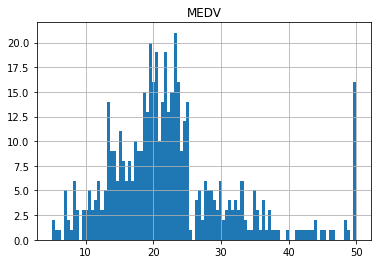

In [6]:
# Целевая переменная - не класс. Сделаем ее классом. Посмотрим, на какие группы разбить MEDV.\
data.hist(column='MEDV',bins=100)

In [7]:
# нормально будет разбить на части кратные 10. От 0 до 10, от 10 до 20 и т.д.
# сравнение результатов модели будет неточным, если разбиение делать грубым.
# чем более точным будет разбиение, тем точнее можно будет сравнить результаты двух моделей
def get_class(v,bs, max_val=50):
    return v//bs
bin_size = 5
data['class'] = data['MEDV'].apply(lambda value: get_class(value, bin_size)).astype(int)

array([[<AxesSubplot:title={'center':'class'}>]], dtype=object)

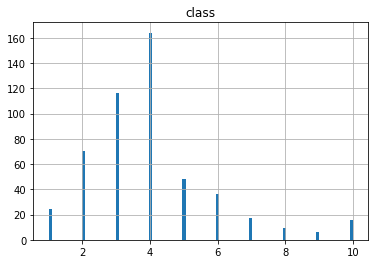

In [8]:
data.hist(column='class',bins=100)

In [9]:
data['class']

0      4
1      4
2      6
3      6
4      7
      ..
501    4
502    4
503    4
504    4
505    2
Name: class, Length: 506, dtype: int32

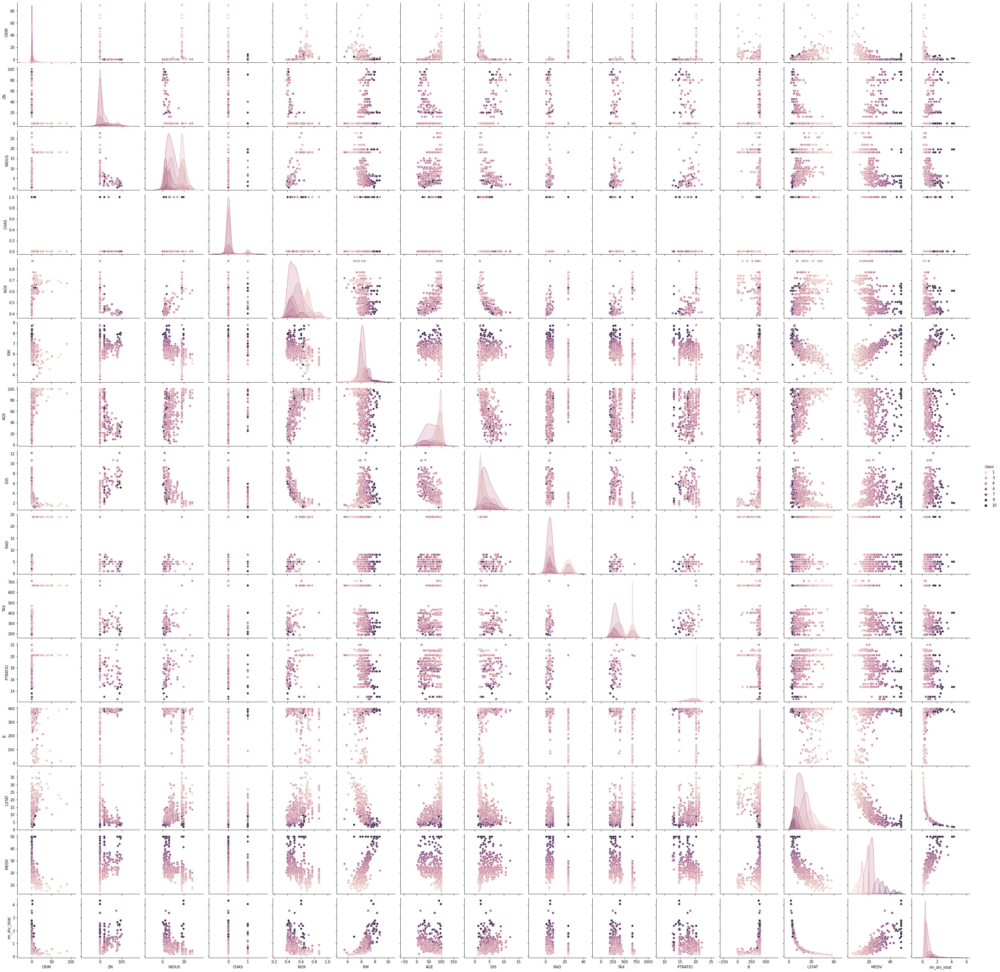

In [10]:
# посмотреть насколько перепутаны созданные классы - кое где перепутаны, а кое где ок, прям градиент цвета
# значит должно нормально делиться деревом
sns.pairplot(data, hue='class', diag_kind="kde")

In [11]:
from sklearn.tree import DecisionTreeClassifier

In [56]:
X = data[[col for col in data.columns if col not in ['MEDV','class']]]
y = data[['class']]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)
clf = DecisionTreeClassifier(max_depth=None)
clf.fit(X_train, y_train)

DecisionTreeClassifier()

In [64]:
clf.predict(X_test.iloc[10:15])*bin_size # проверка, как восстанавливаются оценки стоимости из классов

array([15, 20, 15, 20, 15])

In [66]:
# проверка адекватности работы дерева - не очень плохо вроде бы
data.iloc[X_test.iloc[10:15].index]['MEDV']

218    21.5
9      18.9
414     7.0
78     21.2
323    18.5
Name: MEDV, dtype: float64

In [55]:
from sklearn.metrics import r2_score
# Выберем те MEDV, которые в строках X_test
medv_test = data.iloc[X_test.index]['MEDV']
r2_score(medv_test, clf.predict(X_test)*bin_size)


0.8839631330632601

In [ ]:
# Получается гораздо лучше у дерева! очень странно, даже огрубление не помешало "победить"
# 0.8839631330632601 - дерево
# 0.7804882203838984 - моя линейная регрессия